In [1]:
import pandas as pd
import plotly.express as px
import matplotlib.pyplot as plt
from datetime import datetime
from pyspark.sql import SparkSession
from pyspark.mllib.feature import StandardScaler, PCA
from pyspark.mllib.stat import Statistics
from pyspark.ml.feature import VectorAssembler

Indagando los datasets, dimensionalidad, columnas relacionales y tratamiento de las mismas.

In [2]:
import os
os.environ["JAVA_HOME"] = "C:\Java\jdk-18.0.1.1"

In [3]:
spark = SparkSession.builder.appName("ensayo").getOrCreate()

In [4]:
review = spark.read.json("Yelp/review.json")

In [ ]:
df.write.parquet("C:/Users/KEVIN/Documents/KDG/review1.parquet")

In [ ]:
#spark.stop()

#### Google Earth

In [ ]:
#Google_Earth
metadata_sitios = pd.read_json("Google-Maps/metadata-sitios/9.json", encoding = "utf-8", lines = True)
r_Alabama1 = pd.read_json("Google-Maps/reviews-estados/review-Alabama/1.json", encoding = "utf-8", lines = True)
r_Alabama2 = pd.read_json("Google-Maps/reviews-estados/review-Alabama/11.json", encoding = "utf-8", lines = True)

In [ ]:
metadata_sitios.shape

(275001, 15)

In [ ]:
r_Alabama1.shape

(150000, 8)

In [ ]:
def time_to_date(dataframe):
    dataframe["date"] = pd.to_datetime(dataframe["time"], unit='ms')
    dataframe["date"] = dataframe["date"].dt.strftime("%Y-%m-%d")
    dataframe["date"] = pd.to_datetime(dataframe["date"])
    return dataframe
time_to_date(r_Alabama1)
time_to_date(r_Alabama2)

,user_id,name,time,rating,text,pics,resp,gmap_id,date
0,1.116430e+20,Chris and Shea Tolbert,1542773927242,5,None,None,None,0x88882a58884a0507:0x3bdeae3983aec4dc,2018-11-21
1,1.179291e+20,clint walker,1549501934566,3,None,None,None,0x88882a58884a0507:0x3bdeae3983aec4dc,2019-02-07
2,1.130570e+20,Beth Box,1545440036434,1,None,None,None,0x88882a58884a0507:0x3bdeae3983aec4dc,2018-12-22
3,1.051583e+20,Todd Beasley,1530583141411,5,None,None,None,0x88882a58884a0507:0x3bdeae3983aec4dc,2018-07-03
4,1.139799e+20,brandi hunter,1483573068099,4,None,None,None,0x88882a58884a0507:0x3bdeae3983aec4dc,2017-01-04
...,...,...,...,...,...,...,...,...,...
149995,1.155007e+20,Tabetha Hall,1593285812146,5,We really had a great shopping experience! As ...,[{'url': ['https://lh5.googleusercontent.com/p...,None,0x8889b57e39ea437b:0xe1fc31086a8e39a9,2020-06-27
149996,1.070816e+20,Melissa Johnson,1613173099331,5,Jessica was super helpful and kind. She led us...,None,None,0x8889b57e39ea437b:0xe1fc31086a8e39a9,2021-02-12
149997,1.112208e+20,Blake Barnwell,1615995884765,5,"Best place to find western boots, cowboy hats,...",None,None,0x8889b57e39ea437b:0xe1fc31086a8e39a9,2021-03-17
149998,1.099382e+20,Danny Cassels,1616481924228,4,Rediculas selection of boots .my favorite is t...,None,None,0x8889b57e39ea437b:0xe1fc31086a8e39a9,2021-03-23


In [ ]:
print("minimo",r_Alabama1.date.min())
print("maximo",r_Alabama1.date.max())

minimo 2008-08-25 00:00:00
maximo 2021-09-09 00:00:00


In [ ]:
print("minimo",r_Alabama2.date.min())
print("maximo",r_Alabama2.date.max())

minimo 2009-02-02 00:00:00
maximo 2021-05-19 00:00:00


Sería necesario consolidar los json por estado. No es viable consolidar en un archivo todos los estados ya que se estima serían cerca de 85 millones de registros.

In [ ]:
fig  = px.scatter_mapbox(metadata_sitios, lon = metadata_sitios["longitude"], lat = metadata_sitios["latitude"], color = metadata_sitios["avg_rating"] , size = metadata_sitios["num_of_reviews"])

fig.update_layout(mapbox_style = "open-street-map")
fig.show()

In [ ]:
nulos = metadata_sitios.isnull().sum()
ceros = (metadata_sitios == 0).sum()

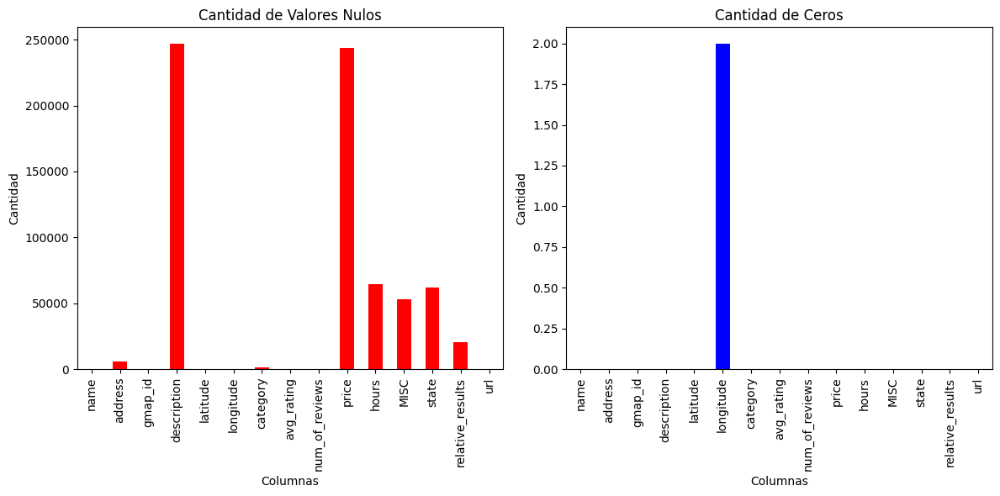

In [ ]:
'''valores nulos y ceros de metadata_sitios'''
etiquetas = nulos.index
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 6))  # Adjust figsize as needed
nulos.plot(kind="bar", color="red", ax=ax1)
ax1.set_title("Cantidad de Valores Nulos")
ax1.set_xlabel("Columnas")
ax1.set_ylabel("Cantidad")
ceros.plot(kind="bar", color="blue", ax=ax2)
ax2.set_title("Cantidad de Ceros")
ax2.set_xlabel("Columnas")
ax2.set_ylabel("Cantidad")
plt.tight_layout()
plt.show()

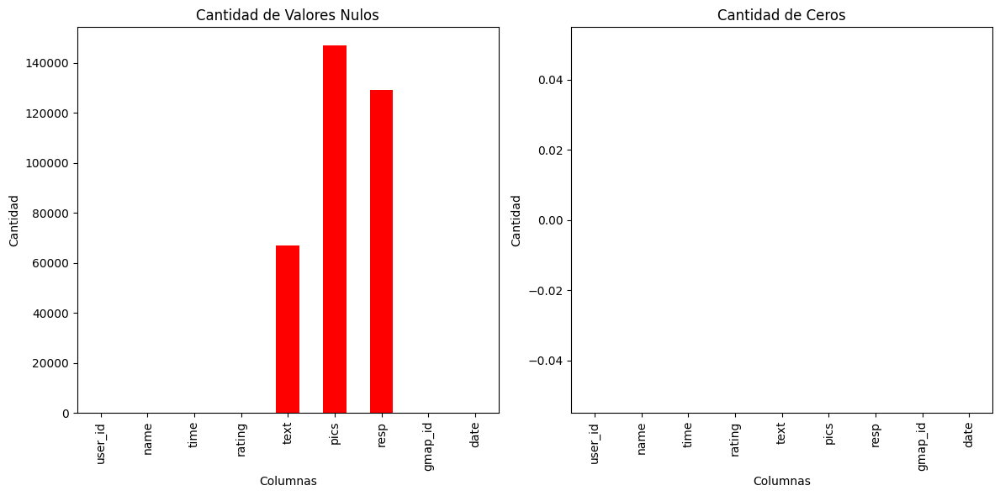

In [ ]:
'''valores nulos y ceros de r_Alabama1'''
nulos = r_Alabama1.isnull().sum()
ceros = (r_Alabama1 == 0).sum()

etiquetas = nulos.index
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 6))  # Adjust figsize as needed
nulos.plot(kind="bar", color="red", ax=ax1)
ax1.set_title("Cantidad de Valores Nulos")
ax1.set_xlabel("Columnas")
ax1.set_ylabel("Cantidad")
ceros.plot(kind="bar", color="blue", ax=ax2)
ax2.set_title("Cantidad de Ceros")
ax2.set_xlabel("Columnas")
ax2.set_ylabel("Cantidad")
plt.tight_layout()
plt.show()

#### Yelp

In [ ]:
#YELP
checkin = pd.read_json("Yelp/checkin.json", encoding = "utf-8", lines = True)
tip = pd.read_json("Yelp/tip.json", encoding = "utf-8", lines = True)


In [ ]:
users = pd.read_parquet("Yelp/user.parquet", engine= "pyarrow")

In [ ]:
bussiness = pd.read_pickle("Yelp/business.pkl")

In [ ]:
bussiness.head(1)

,business_id,name,address,city,state,postal_code,latitude,longitude,stars,review_count,...,state,postal_code,latitude,longitude,stars,review_count,is_open,attributes,categories,hours
0,Pns2l4eNsfO8kk83dixA6A,"Abby Rappoport, LAC, CMQ","1616 Chapala St, Ste 2",Santa Barbara,NaN,93101,34.426679,-119.711197,5.0,7,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


##### Reviews .json

In [8]:
review.printSchema()

root
 |-- business_id: string (nullable = true)
 |-- cool: long (nullable = true)
 |-- date: string (nullable = true)
 |-- funny: long (nullable = true)
 |-- review_id: string (nullable = true)
 |-- stars: double (nullable = true)
 |-- text: string (nullable = true)
 |-- useful: long (nullable = true)
 |-- user_id: string (nullable = true)



In [ ]:
#Buscando Valores Faltantes
from pyspark.sql.functions import col, count, isnan, when
review.select([count(when(col(c).isNull(),c)).alias(c) for c in review.columns]).show()

+-----------+----+----+-----+---------+-----+----+------+-------+
|business_id|cool|date|funny|review_id|stars|text|useful|user_id|
+-----------+----+----+-----+---------+-----+----+------+-------+
|          0|   0|   0|    0|        0|    0|   0|     0|      0|
+-----------+----+----+-----+---------+-----+----+------+-------+



In [11]:
print((review.count(), len(review.columns)))

(6990280, 9)


In [19]:
review.describe(["stars"]).show()

+-------+------------------+
|summary|             stars|
+-------+------------------+
|  count|           6990280|
|   mean|  3.74858374771826|
| stddev|1.4787045052556855|
|    min|               1.0|
|    max|               5.0|
+-------+------------------+



In [ ]:
checkin.head(3)

,business_id,date
0,---kPU91CF4Lq2-WlRu9Lw,"2020-03-13 21:10:56, 2020-06-02 22:18:06, 2020..."
1,--0iUa4sNDFiZFrAdIWhZQ,"2010-09-13 21:43:09, 2011-05-04 23:08:15, 2011..."
2,--30_8IhuyMHbSOcNWd6DQ,"2013-06-14 23:29:17, 2014-08-13 23:20:22"


In [ ]:
tip.head(5)

,user_id,business_id,text,date,compliment_count
0,AGNUgVwnZUey3gcPCJ76iw,3uLgwr0qeCNMjKenHJwPGQ,Avengers time with the ladies.,2012-05-18 02:17:21,0
1,NBN4MgHP9D3cw--SnauTkA,QoezRbYQncpRqyrLH6Iqjg,They have lots of good deserts and tasty cuban...,2013-02-05 18:35:10,0
2,-copOvldyKh1qr-vzkDEvw,MYoRNLb5chwjQe3c_k37Gg,It's open even when you think it isn't,2013-08-18 00:56:08,0
3,FjMQVZjSqY8syIO-53KFKw,hV-bABTK-glh5wj31ps_Jw,Very decent fried chicken,2017-06-27 23:05:38,0
4,ld0AperBXk1h6UbqmM80zw,_uN0OudeJ3Zl_tf6nxg5ww,Appetizers.. platter special for lunch,2012-10-06 19:43:09,0
